## Plotting/animating COVID cases in the UK
Using the data scraped from GOV.uk previously, here we plot an animated choropleth tracking the spread of COVID throughout the UK

Data sources: [UK Area boundaries](https://geoportal.statistics.gov.uk/datasets/ons::local-authority-districts-may-2021-uk-bfe/about), [COVID Data](https://coronavirus.data.gov.uk/details/cases?areaType=ltla&areaName=Aberdeen%20City), [London Boroughs](https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london)


In [2]:
import numpy as np
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt

%matplotlib notebook

In [3]:
df = gpd.read_file('datasets/merged_df.shp').set_index('local_auth')

In [4]:
dates = pd.to_datetime(df.columns[:-1]).sort_values() # Last column is geometry

In [5]:
dates

DatetimeIndex(['2020-03-04', '2020-03-05', '2020-03-06', '2020-03-07',
               '2020-03-08', '2020-03-09', '2020-03-10', '2020-03-11',
               '2020-03-12', '2020-03-13',
               ...
               '2021-11-29', '2021-11-30', '2021-12-01', '2021-12-02',
               '2021-12-03', '2021-12-04', '2021-12-05', '2021-12-06',
               '2021-12-07', '2021-12-08'],
              dtype='datetime64[ns]', length=645, freq=None)

In [6]:
df.columns = pd.to_datetime(df.columns[:-1]).tolist() + df.columns[-1:].tolist() # Set column names to datetime objs

In [7]:
# The UK plot is nice, but would be nice to have a zoomed inset of London - this will give me a list of the boroughs

fp = 'datasets/London_Borough_Excluding_MHW.dbf'

london_df = gpd.read_file(fp)

boroughs = london_df.NAME.tolist()

boroughs.remove('Hackney')
boroughs.remove('City of London')
boroughs += ['Hackney and City of London']
boroughs

['Kingston upon Thames',
 'Croydon',
 'Bromley',
 'Hounslow',
 'Ealing',
 'Havering',
 'Hillingdon',
 'Harrow',
 'Brent',
 'Barnet',
 'Lambeth',
 'Southwark',
 'Lewisham',
 'Greenwich',
 'Bexley',
 'Enfield',
 'Waltham Forest',
 'Redbridge',
 'Sutton',
 'Richmond upon Thames',
 'Merton',
 'Wandsworth',
 'Hammersmith and Fulham',
 'Kensington and Chelsea',
 'Westminster',
 'Camden',
 'Tower Hamlets',
 'Islington',
 'Haringey',
 'Newham',
 'Barking and Dagenham',
 'Hackney and City of London']

In [8]:
import matplotlib as mpl

# set up the colorbar

vmax, vmin = (max(df.max()), min(df.min()))
cmap_name = 'plasma'
sm = plt.cm.ScalarMappable(cmap=cmap_name, norm = mpl.colors.LogNorm(vmin=0.1, vmax=vmax)) # Can't have 0 on log scale
sm._A = []

/Users/gabrielcoulter/opt/anaconda3/envs/data_science_env/lib/python3.7/site-packages/ipykernel_launcher.py:5: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  """


<IPython.core.display.Javascript object>


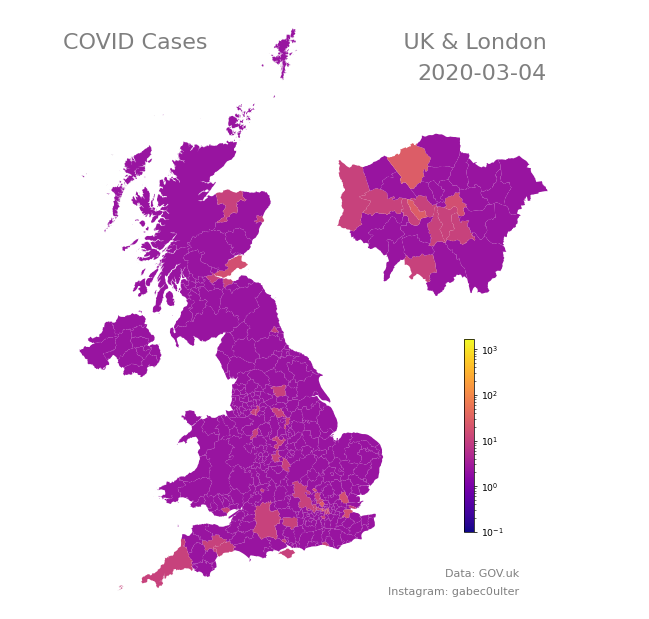

In [40]:
%matplotlib notebook

fig = plt.figure(figsize=(10,10))
gs = fig.add_gridspec(10,10)

ax1 = fig.add_subplot(gs[:, :7])    # Main UK figure
ax2 = fig.add_subplot(gs[2:5, 4:7]) # London Inset
ax3 = fig.add_subplot(gs[5:9, 5:6]) # Colorbar

date = dates[0]

# Main UK figure
df.plot(column=date, cmap=cmap_name, ax=ax1, norm=mpl.colors.LogNorm(vmin=0.001, vmax=vmax))#vmin=vmin, vmax=vmax)

# London inset
df.loc[boroughs, :].plot(column=date, cmap=cmap_name, ax=ax2,norm=mpl.colors.LogNorm(vmin=0.001, vmax=vmax))# vmin=vmin, vmax=vmax)

ax1.axis('off')
ax2.axis('off')
ax3.axis('off')

ax2.set_title(f'COVID Cases                            UK & London\n{str(date)[:10]}', fontdict={'fontsize':'24', 
                                                          'fontweight':3}, linespacing=1.7, alpha=0.5, ha='right',va='bottom', position=(.95,1.2))

ax3.annotate('Data: GOV.uk\nInstagram: gabec0ulter', linespacing=2, xy=(.8, 0.08), xycoords='figure fraction', ha='right', va='top', 
            fontsize=12, alpha=0.5)


cbar = fig.colorbar(sm, ax=ax3, fraction=0.25, pad=0.04, shrink=0.8)#, panchor=(-10, 10))#, panchor=(2, 0.2))


plt.subplots_adjust(left=-0.2, right=1.4, top=1, bottom=0.0) # Adjustment to fill space

# plt.show()

In [15]:
df

,2021-12-08 00:00:00,2021-12-07 00:00:00,2021-12-06 00:00:00,2021-12-05 00:00:00,2021-12-04 00:00:00,2021-12-03 00:00:00,2021-12-02 00:00:00,2021-12-01 00:00:00,2021-11-30 00:00:00,2021-11-29 00:00:00,...,2020-03-12 00:00:00,2020-03-11 00:00:00,2020-03-10 00:00:00,2020-03-09 00:00:00,2020-03-08 00:00:00,2020-03-07 00:00:00,2020-03-06 00:00:00,2020-03-05 00:00:00,2020-03-04 00:00:00,geometry
local_auth,,,,,,,,,,,,,,,,,,,,,
Aberdeen City,4,57,122,85,77,81,101,93,119,129,...,3,0,0,0,0,0,0,0,1,"MULTIPOLYGON (((395326.897 800228.397, 395315...."
Aberdeenshire,4,50,114,96,81,97,80,117,117,150,...,3,0,1,0,1,2,0,0,0,"MULTIPOLYGON (((383521.198 771234.696, 383524...."
Adur,10,48,48,44,54,51,60,52,53,67,...,0,0,0,0,0,0,0,0,0,"POLYGON ((515046.998 109606.605, 515058.401 10..."
Allerdale,10,21,31,24,15,31,33,29,42,49,...,1,0,0,0,0,0,0,0,0,"POLYGON ((319854.491 563292.602, 320050.835 56..."
Amber Valley,14,74,64,61,65,89,91,88,86,107,...,1,0,0,0,0,0,0,0,0,"POLYGON ((433925.598 359592.197, 433978.499 35..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Wyre Forest,16,64,52,55,52,52,59,55,96,74,...,1,1,1,1,0,0,0,0,0,"POLYGON ((380290.099 283749.297, 380235.896 28..."
York,24,117,151,101,94,125,108,145,120,156,...,0,0,1,0,0,0,0,0,0,"POLYGON ((464216.997 462110.902, 464266.203 46..."
Hackney and City of London,68,252,241,141,152,149,205,188,170,186,...,6,8,1,1,2,0,0,0,0,"POLYGON ((532140.296 182191.897, 532141.185 18..."


In [16]:
df = df.replace(0,0.1)

In [19]:
rolled_df = df.T.iloc[:-1,:].sort_index().rolling(7).mean().dropna().T

rolled_df['geometry'] = df.geometry

rolled_df.head()

,2020-03-10 00:00:00,2020-03-11 00:00:00,2020-03-12 00:00:00,2020-03-13 00:00:00,2020-03-14 00:00:00,2020-03-15 00:00:00,2020-03-16 00:00:00,2020-03-17 00:00:00,2020-03-18 00:00:00,2020-03-19 00:00:00,...,2021-11-30 00:00:00,2021-12-01 00:00:00,2021-12-02 00:00:00,2021-12-03 00:00:00,2021-12-04 00:00:00,2021-12-05 00:00:00,2021-12-06 00:00:00,2021-12-07 00:00:00,2021-12-08 00:00:00,geometry
local_auth,,,,,,,,,,,,,,,,,,,,,
Aberdeen City,0.228571,0.100000,0.514286,0.928571,0.928571,0.928571,0.928571,1.200000,1.328571,0.914286,...,111.142857,103.000000,99.285714,96.857143,100.142857,97.857143,96.857143,88.000000,75.285714,"MULTIPOLYGON (((395326.897 800228.397, 395315...."
Aberdeenshire,0.628571,0.628571,1.042857,1.042857,0.771429,0.771429,0.771429,0.642857,0.642857,0.228571,...,107.142857,104.571429,96.857143,100.142857,107.000000,105.428571,100.285714,90.714286,74.571429,"MULTIPOLYGON (((383521.198 771234.696, 383524...."
Adur,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.100000,0.228571,...,45.428571,44.857143,49.285714,51.000000,52.142857,54.428571,51.714286,51.000000,45.000000,"POLYGON ((515046.998 109606.605, 515058.401 10..."
Allerdale,0.100000,0.100000,0.228571,0.357143,0.357143,0.357143,0.628571,0.757143,1.171429,1.457143,...,35.428571,33.714286,33.142857,34.142857,33.285714,31.857143,29.285714,26.285714,23.571429,"POLYGON ((319854.491 563292.602, 320050.835 56..."
Amber Valley,0.100000,0.100000,0.228571,0.642857,0.914286,1.328571,1.600000,1.728571,1.857143,1.857143,...,74.571429,77.142857,80.285714,81.714286,84.285714,83.857143,77.714286,76.000000,65.428571,"POLYGON ((433925.598 359592.197, 433978.499 35..."


<IPython.core.display.Javascript object>


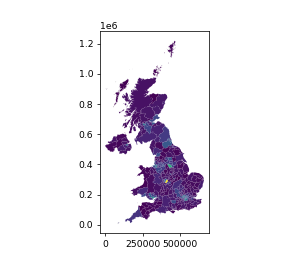

In [42]:
rolled_df.plot(dates[30])


<IPython.core.display.Javascript object>


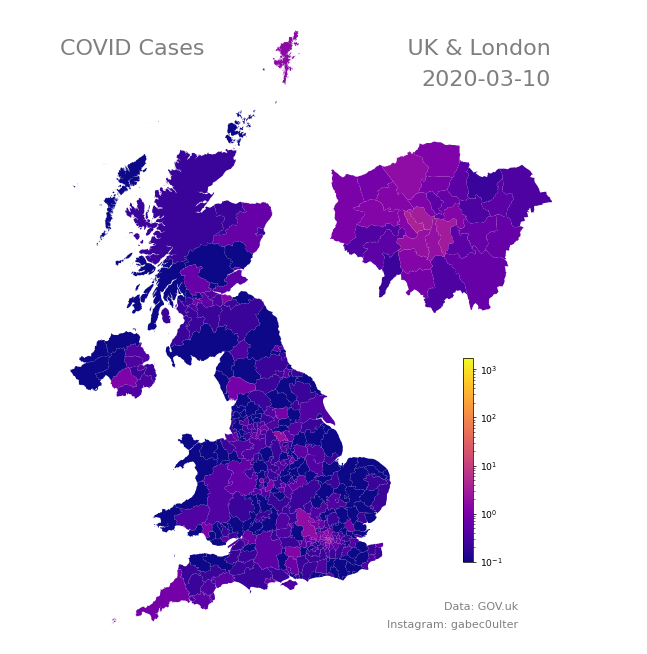

In [44]:
new_dates = rolled_df.columns[:-1]

for i, date in enumerate(new_dates):
    
    fig = plt.figure(figsize=(10,10))
    
    gs = fig.add_gridspec(10,10)

    ax1 = fig.add_subplot(gs[:, :7])
    ax2 = fig.add_subplot(gs[2:5, 4:7])
    ax3 = fig.add_subplot(gs[5:9, 5:6])

    rolled_df.plot(column=date, cmap=cmap_name, ax=ax1, norm=mpl.colors.LogNorm(vmin=0.1, vmax=vmax))#, vmin=0.001, vmax=vmax)

    rolled_df.loc[boroughs, :].plot(column=date, cmap=cmap_name, ax=ax2,norm=mpl.colors.LogNorm(vmin=0.1, vmax=vmax))#, vmin=0.001, vmax=vmax)

    ax1.axis('off')
    ax2.axis('off')
    ax3.axis('off')

    ax2.set_title(f'COVID Cases                             UK & London\n{str(date)[:10]}', fontdict={'fontsize':'24', 
                                                              'fontweight':3}, linespacing=1.7, alpha=0.5, ha='right',va='bottom', position=(.95,1.2))

    ax3.annotate('Data: GOV.uk\nInstagram: gabec0ulter', linespacing=2, xy=(.8, 0.08), xycoords='figure fraction', ha='right', va='top', 
                fontsize=12, alpha=0.5)

    cbar = fig.colorbar(sm, ax=ax3, fraction=0.25, pad=0.04, shrink=0.8)#, panchor=(-10, 10))#, panchor=(2, 0.2))


    plt.subplots_adjust(left=-0.2, right=1.4, top=1, bottom=0.0)

#     plt.savefig(f'frames/COVID_cases_7da_{i:04}.png')
    break
    plt.clf()

In [45]:
! ffmpeg -i frames/COVID_cases_7da_%04d.png -vf palettegen palette.png  # needs palette otherwise colours are messed up

In [46]:
! ffmpeg -framerate 15 -i frames/COVID_cases_7da_%04d.png -i palette.png -lavfi paletteuse -final_delay 300 UK_COVID_cases.gif 
    # create gif from frames

ffmpeg version 4.4 Copyright (c) 2000-2021 the FFmpeg developers
  built with Apple clang version 12.0.5 (clang-1205.0.22.9)
  configuration: --prefix=/usr/local/Cellar/ffmpeg/4.4_2 --enable-shared --enable-pthreads --enable-version3 --cc=clang --host-cflags= --host-ldflags= --enable-ffplay --enable-gnutls --enable-gpl --enable-libaom --enable-libbluray --enable-libdav1d --enable-libmp3lame --enable-libopus --enable-librav1e --enable-librubberband --enable-libsnappy --enable-libsrt --enable-libtesseract --enable-libtheora --enable-libvidstab --enable-libvorbis --enable-libvpx --enable-libwebp --enable-libx264 --enable-libx265 --enable-libxml2 --enable-libxvid --enable-lzma --enable-libfontconfig --enable-libfreetype --enable-frei0r --enable-libass --enable-libopencore-amrnb --enable-libopencore-amrwb --enable-libopenjpeg --enable-libspeex --enable-libsoxr --enable-libzmq --enable-libzimg --disable-libjack --disable-indev=jack --enable-avresample --enable-videotoolbox
  libavutil      5

## Final GIF:

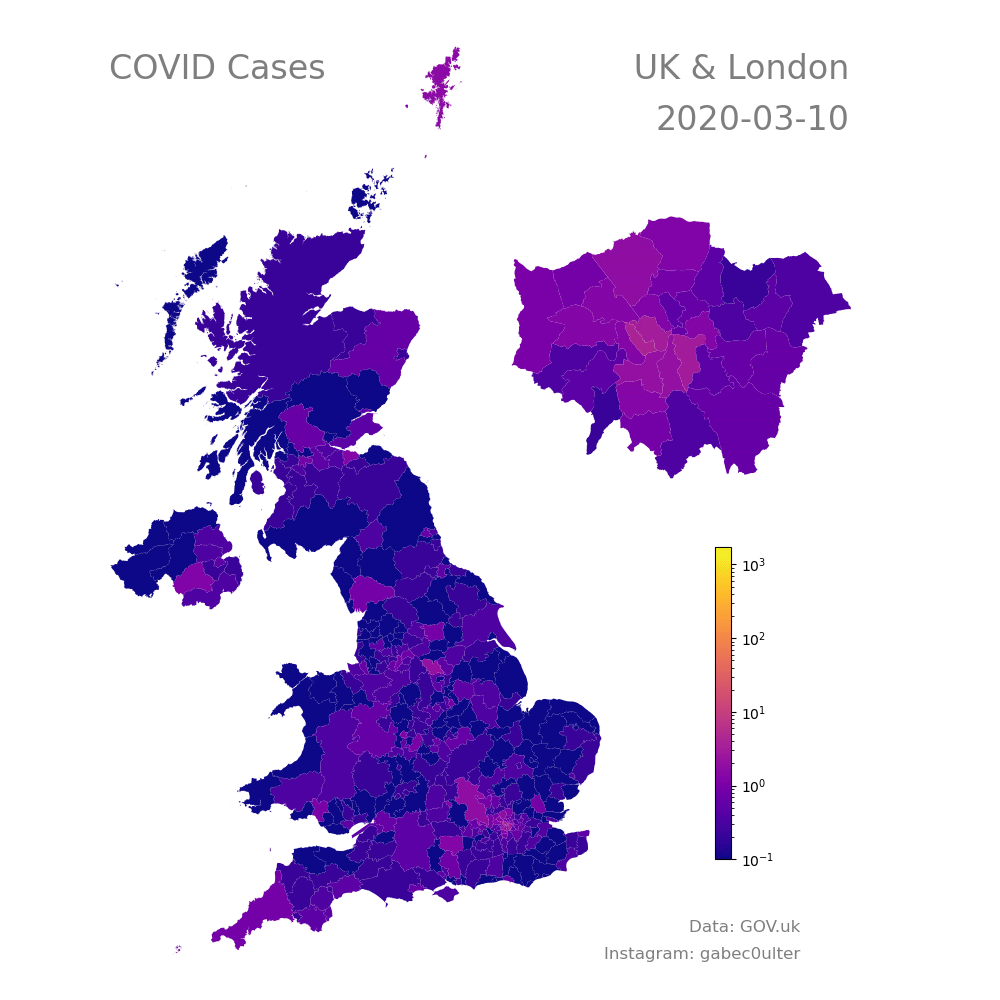